In [0]:
from pyspark.sql import SQLContext
import pyspark
from pyspark.sql.functions import hour, mean, min, col, variance, stddev, udf, pandas_udf
import pandas as pd
from pyspark.sql.types import IntegerType, StringType 
from pyspark.sql.functions import row_number, monotonically_increasing_id 
from pyspark.sql.window import Window
import math
import matplotlib.pyplot as plt
from pyspark.sql import functions as F
import numpy as np
from scipy.optimize import curve_fit
import collections

In [0]:
line_man_data = spark.sql("SELECT * FROM line_man").withColumnRenamed("date", "date_day")
bkk_2021 = spark.sql("SELECT * FROM bangkok_new").filter(col('year')==2021)

In [0]:
line_man_data.count()

316224

In [0]:
line_man_data.filter(col('date_day')=='2021-06-29').count()

288348

In [0]:
%sql select * from line_man

TID,id,gid,id_source,name,distance,cuisine,price_level,lat,lon,image_url,category,category_international,opening_hours,id_chain,name_chain,reviews_nr,rating,address,facebook,phone,email,url,RunID,RunDate,InsertUpdateTime,searched_lat,searched_lon,date,time,year,month,day
43432,658835,09VxGbexRRq40NnFNXTdex199Fx42m,658835Qr,เกยพุง หมูกระทะช่างโล พัทยาใต้-หลังรร.เมือง6,5674.524061194977,หมูกระทะ,101 - 250 บาท,12.915687,100.901437,https://img.wongnai.com/p/_-x_/2020/12/05/bb579a75f219466295ce2fb6bdfd330d.jpg,หมูกระทะ,Thai BBQ,"{'open': True, 'message': 'จนถึง 22:00', 'temporaryCloseStartDate': None, 'temporaryCloseEndDate': None, 'closingSoon': False}",null,null,0,0.00,"{'street': '315/22, ซอยธรรมสามัคคี 10/5, ตำบลนาเกลือ, อ.บางละมุง, จ.ชลบุรี, 20150, ประเทศไทย', 'hint': '7-11 หลังทางรถไฟ', 'subDistrict': {'id': 16502, 'name': 'เมืองพัทยา'}, 'district': {'id': 301, 'name': 'บางละมุง'}, 'city': {'id': 269, 'name': 'ชลบุรี'}}",https://www.facebook.com/buffet99banglamung,"0979197996,0897922287",yupharach_rct@hotmail.com,https://www.wongnai.com/delivery/businesses/658835Qr,36543,2021-06-29 11:55:33,2021-06-29 20:02:25,12.9667,100.9,2021-06-29,11:55:33,2021,06,29
43433,212882,09VwpBTRS8s3jF4Hmxsysw2NaJ7lbq,212882nV,Fivestar j restaurant,5141.253355217888,อาหารมังสวิรัติ/อาหารนานาชาติ/อาหารไทย,101 - 250 บาท,12.923786171772376,100.88234047486878,https://img.wongnai.com/p/_-x_/2020/05/09/9287f9a81d524faeae978c50a2258e35.jpg,อาหารมังสวิรัติ/อาหารนานาชาติ/อาหารไทย,Vegeterian/International Food/Thai,"{'open': True, 'message': 'จนถึง 21:00', 'temporaryCloseStartDate': None, 'temporaryCloseEndDate': None, 'closingSoon': False}",null,null,2,3.85,"{'street': 'ถนน พัทยา สาย 3 เมืองพัทยา อำเภอ บางละมุง ชลบุรี 20150 ประเทศไทย', 'hint': 'ร้านอยู่บนถนนพัทยาใต้ตัดกับถนนสาย3', 'subDistrict': {'id': 16502, 'name': 'เมืองพัทยา'}, 'district': {'id': 301, 'name': 'บางละมุง'}, 'city': {'id': 269, 'name': 'ชลบุรี'}}",https://www.facebook.com/fivestarj/,"038-421-105,097-235-4209",Info@fivestarj.com,https://www.wongnai.com/delivery/businesses/212882nV,36543,2021-06-29 11:55:33,2021-06-29 20:02:26,12.9667,100.9,2021-06-29,11:55:33,2021,06,29
43434,748928,09VxKzwiMUuC1H1oDx9xoX49WLfT3C,748928Ay,amani pattaya,5389.393106357031,คาเฟ่/อาหารญี่ปุ่น/อื่นๆ,251 - 500 บาท,12.91830210000001,100.90267329999999,https://img.wongnai.com/p/_-x_/2021/01/29/7a21345a04ac4a2b9ab202ab72f27d42.jpg,คาเฟ่/อาหารญี่ปุ่น/อื่นๆ,Cafe/Japanese/Other,"{'open': False, 'message': 'ชั่วคราว', 'temporaryCloseStartDate': {'iso': '2021-04-27T00:00:00+07:00', 'full': 'อ., 27 เม.ย. 2021 00:00:00', 'timePassed': 'เมื่อ 2 เดือนที่แล้ว'}, 'temporaryCloseEndDate': None, 'closingSoon': False}",null,null,2,0.00,"{'street': '109/212, ถนนเลี่ยงเมืองพัทยา, ตำบลนาเกลือ, อ.บางละมุง, จ.ชลบุรี, 20150, ประเทศไทย', 'hint': '', 'subDistrict': {'id': 16502, 'name': 'เมืองพัทยา'}, 'district': {'id': 301, 'name': 'บางละมุง'}, 'city': {'id': 269, 'name': 'ชลบุรี'}}",https://www.facebook.com/https://www.facebook,0981523232,null,https://www.wongnai.com/delivery/businesses/748928Ay,36543,2021-06-29 11:55:33,2021-06-29 20:02:26,12.9667,100.9,2021-06-29,11:55:33,2021,06,29
43435,702843,09VxJ6KdoA0knSXmlQmPw0kZjj4qo6,702843hI,เนยหอม ข้าวมันไก่,5096.8581928510275,อาหารไทย,null,12.9271274,100.9237346,https://img.wongnai.com/p/_-x_/2020/12/17/32aaf9b361c848daa0b6d4432e9a75a6.jpg,อาหารไทย,Thai,"{'open': True, 'message': 'จนถึงวันพุธ เวลา 02:00', 'temporaryCloseStartDate': None, 'temporaryCloseEndDate': None, 'closingSoon': False}",null,null,0,0.00,"{'street': '54/60 Noen Phlap Whan, เมืองพัทยา อำเภอบางละมุง ชลบุรี ประเทศไทย', 'hint': '', 'subDistrict': {'id': 307, 'name': 'หนองปรือ'}, 'district': {'id': 301, 'name': 'บางละมุง'}, 'city': {'id': 269, 'name': 'ชลบุรี'}}",null,0873616083,null,https://www.wongnai.com/delivery/businesses/702843hI,36543,2021-06-29 11:55:33,2021-06-29 20:02:26,12.9667,100.9,2021-06-29,11:55:33,2021,06,29
43436,615492,09VxDrotCW2rX1tO4a9jjE55uiohDd,615492Rd,ไม้หมอนแมลงทอด,5342.074591514111,อาหารไทย,nul

In [0]:
%sql select * from bkk_weather where date_day='2021-06-29'

date,temperature_2m,relative_humidity_2m,precipitation,rain,pressure_msl,surface_pressure,cloud_cover,wind_speed_10m,dates,date_day,time,year,month,day
2021-06-29T00:00:00Z,25.05,79.71836,0.0,0.0,1014.2,1014.2,72.600006,41.33107,2021-06-29 00:00:00,2021-06-29,00:00:00,2021,06,29 00:00:00
2021-06-29T01:00:00Z,25.1,78.511925,0.0,0.0,1014.8,1014.8,81.0,42.340958,2021-06-29 01:00:00,2021-06-29,01:00:00,2021,06,29 01:00:00
2021-06-29T02:00:00Z,25.25,77.33734,0.0,0.0,1015.2,1015.2,83.4,42.730953,2021-06-29 02:00:00,2021-06-29,02:00:00,2021,06,29 02:00:00
2021-06-29T03:00:00Z,25.25,76.39208,0.0,0.0,1015.3,1015.3,81.6,43.516838,2021-06-29 03:00:00,2021-06-29,03:00:00,2021,06,29 03:00:00
2021-06-29T04:00:00Z,25.55,74.35198,0.0,0.0,1015.0,1015.0,100.0,41.718082,2021-06-29 04:00:00,2021-06-29,04:00:00,2021,06,29 04:00:00
2021-06-29T05:00:00Z,25.6,72.101295,0.0,0.0,1014.5,1014.5,100.0,41.492245,2021-06-29 05:00:00,2021-06-29,05:00:00,2021,06,29 05:00:00
2021-06-29T06:00:00Z,25.55,70.5468,0.0,0.0,1014.2,1014.2,100.0,40.336067,2021-06-29 06:00:00,2021-06-29,06:00:00,2021,06,29 06:00:00
2021-06-29T07:00:00Z,25.6,71.214714,0.0,0.0,1013.9,1013.9,100.0,39.28456,2021-06-29 07:00:00,2021-06-29,07:00:00,2021,06,29 07:00:00
2021-06-29T08:00:00Z,25.6,70.775,0.0,0.0,1013.3,1013.3,100.0,40.42593,2021-06-29 08:00:00,2021-06-29,08:00:00,2021,06,29 08:00:00
2021-06-29T09:00:00Z,25.55,69.46065,0.0,0.0,1013.2,1013.2,100.0,41.046314,2021-06-29 09:00:00,2021-06-29,09:00:00,2021,06,29 09:00:00


In [0]:
bkk_2021_06_09 = spark.sql("select * from bkk_weather where date_day='2021-06-29'")

date,temperature_2m,relative_humidity_2m,precipitation,rain,pressure_msl,surface_pressure,cloud_cover,wind_speed_10m,dates,date_day,time,year,month,day
2021-06-29T00:00:00Z,25.05,79.71836,0.0,0.0,1014.2,1014.2,72.600006,41.33107,2021-06-29 00:00:00,2021-06-29,00:00:00,2021,06,29 00:00:00
2021-06-29T01:00:00Z,25.1,78.511925,0.0,0.0,1014.8,1014.8,81.0,42.340958,2021-06-29 01:00:00,2021-06-29,01:00:00,2021,06,29 01:00:00
2021-06-29T02:00:00Z,25.25,77.33734,0.0,0.0,1015.2,1015.2,83.4,42.730953,2021-06-29 02:00:00,2021-06-29,02:00:00,2021,06,29 02:00:00
2021-06-29T03:00:00Z,25.25,76.39208,0.0,0.0,1015.3,1015.3,81.6,43.516838,2021-06-29 03:00:00,2021-06-29,03:00:00,2021,06,29 03:00:00
2021-06-29T04:00:00Z,25.55,74.35198,0.0,0.0,1015.0,1015.0,100.0,41.718082,2021-06-29 04:00:00,2021-06-29,04:00:00,2021,06,29 04:00:00
2021-06-29T05:00:00Z,25.6,72.101295,0.0,0.0,1014.5,1014.5,100.0,41.492245,2021-06-29 05:00:00,2021-06-29,05:00:00,2021,06,29 05:00:00
2021-06-29T06:00:00Z,25.55,70.5468,0.0,0.0,1014.2,1014.2,100.0,40.336067,2021-06-29 06:00:00,2021-06-29,06:00:00,2021,06,29 06:00:00
2021-06-29T07:00:00Z,25.6,71.214714,0.0,0.0,1013.9,1013.9,100.0,39.28456,2021-06-29 07:00:00,2021-06-29,07:00:00,2021,06,29 07:00:00
2021-06-29T08:00:00Z,25.6,70.775,0.0,0.0,1013.3,1013.3,100.0,40.42593,2021-06-29 08:00:00,2021-06-29,08:00:00,2021,06,29 08:00:00
2021-06-29T09:00:00Z,25.55,69.46065,0.0,0.0,1013.2,1013.2,100.0,41.046314,2021-06-29 09:00:00,2021-06-29,09:00:00,2021,06,29 09:00:00


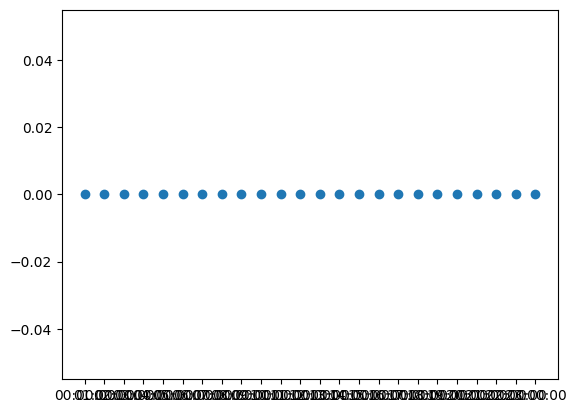

In [0]:
display(bkk_2021_06_09)

xs = [val.time for val in bkk_2021_06_09.select('time').collect()]
ys = [val.rain for val in bkk_2021_06_09.select('rain').collect()]

plt.scatter(xs, ys)

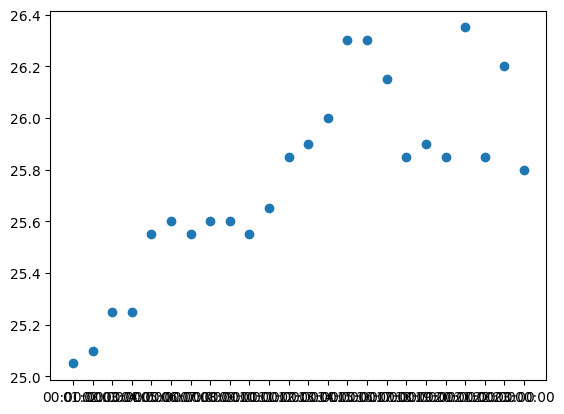

In [0]:
xs = [val.time for val in bkk_2021_06_09.select('time').collect()]
ys = [val.temperature_2m for val in bkk_2021_06_09.select('temperature_2m').collect()]

plt.scatter(xs, ys)

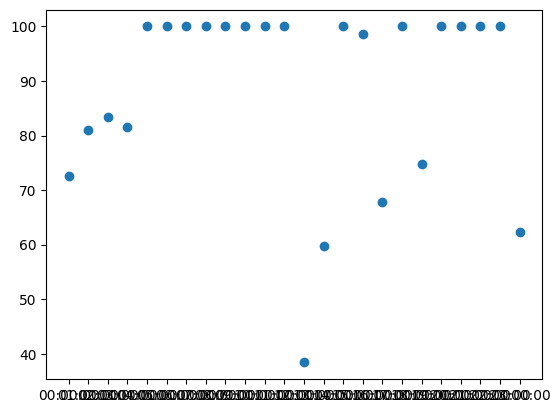

In [0]:


xs = [val.time for val in bkk_2021_06_09.select('time').collect()]
ys = [val.cloud_cover for val in bkk_2021_06_09.select('cloud_cover').collect()]

plt.scatter(xs, ys)

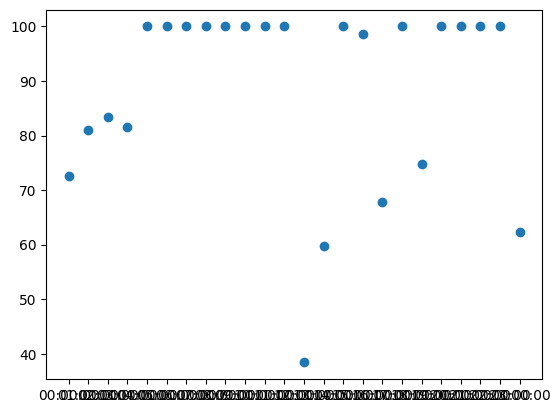

In [0]:
xs = [val.time for val in bkk_2021_06_09.select('time').collect()]
ys = [val.cloud_cover for val in bkk_2021_06_09.select('cloud_cover').collect()]

plt.scatter(xs, ys)

In [0]:
from pyspark.sql.functions import col, when, concat, lpad, lit

line_man_data = line_man_data.withColumn(
    "time",
    when(
        col("time").substr(4, 5).cast("int") > 30,
        concat(lpad(((col("time").substr(1, 2).cast("int") + 1) % 24).cast("string"), 2, '0'), lit(':00:00'))
    ).otherwise(
        concat(col("time").substr(1, 2), lit(':00:00'))
    )
)

In [0]:
display(bkk_2021)

date,temperature_2m,relative_humidity_2m,dew_point_2m,rain,pressure_msl,surface_pressure,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,wind_speed_100m,wind_direction_10m,dates,date_day,time,year,month,day
2021-09-11T14:00:00Z,26.706501,83.39284,23.6565,0.0,1007.9,1007.09674,88.8,0.0,98.0,100.0,10.440001,21.67487,270.0,2021-09-11 14:00:00,2021-09-11,14:00:00,2021,09,11 14:00:00
2021-09-11T15:00:00Z,26.6065,84.13836,23.706501,0.0,1008.3,1007.49603,88.200005,0.0,97.0,100.0,9.3669195,19.852295,267.79745,2021-09-11 15:00:00,2021-09-11,15:00:00,2021,09,11 15:00:00
2021-09-11T16:00:00Z,26.1565,86.40265,23.706501,0.0,1008.1,1007.295,49.800003,0.0,33.0,100.0,8.647496,18.888851,272.3859,2021-09-11 16:00:00,2021-09-11,16:00:00,2021,09,11 16:00:00
2021-09-11T17:00:00Z,25.706501,88.73573,23.706501,0.0,1007.7,1006.894,45.600002,0.0,26.0,100.0,8.64,18.806337,270.0,2021-09-11 17:00:00,2021-09-11,17:00:00,2021,09,11 17:00:00
2021-09-11T18:00:00Z,25.456501,89.79173,23.6565,0.0,1007.0,1006.194,59.4,0.0,49.0,100.0,9.3876505,20.532627,265.60138,2021-09-11 18:00:00,2021-09-11,18:00:00,2021,09,11 18:00:00
2021-09-11T19:00:00Z,25.3065,90.32365,23.6065,0.0,1006.5,1005.694,67.8,0.0,63.0,100.0,9.007196,19.917469,272.29056,2021-09-11 19:00:00,2021-09-11,19:00:00,2021,09,11 19:00:00
2021-09-11T20:00:00Z,25.2565,89.7773,23.456501,0.0,1006.0,1005.19415,66.0,0.0,60.0,100.0,10.805999,22.065973,268.09088,2021-09-11 20:00:00,2021-09-11,20:00:00,2021,09,11 20:00:00
2021-09-11T21:00:00Z,25.2565,88.16563,23.1565,0.0,1005.5,1004.6946,55.800003,0.0,43.0,100.0,12.24,24.609364,270.0,2021-09-11 21:00:00,2021-09-11,21:00:00,2021,09,11 21:00:00
2021-09-11T22:00:00Z,25.206501,87.629715,23.0065,0.0,1005.7,1004.8944,67.8,0.0,63.0,100.0,11.609651,23.510508,277.1249,2021-09-11 22:00:00,2021-09-11,22:00:00,2021,09,11 22:00:00
2021-09-11T23:00:00Z,25.206501,87.10079,22.9065,0.0,1005.9,1005.09424,89.40001,0.0,100.0,98.0,10.495713,22.380884,275.90604,2021-09-11 23:00:00,2021-09-11,23:00:00,2021,09,11 23:00:00


In [0]:
# Convert Spark DataFrames to Pandas DataFrames
line_man_pd = line_man_data.toPandas()
bkk_2021_pd = bkk_2021.toPandas()

# Check the column names
if 'date_day' in line_man_pd.columns and 'date_day' in bkk_2021_pd.columns:
    merged = pd.merge(line_man_pd, bkk_2021_pd, on=["date_day", "time"], how='inner')
else:
    print("Column 'date_day' does not exist in one or both DataFrames")

display(merged)

TID,id,gid,id_source,name,distance,cuisine,price_level,lat,lon,image_url,category,category_international,opening_hours,id_chain,name_chain,reviews_nr,rating,address,facebook,phone,email,url,RunID,RunDate,InsertUpdateTime,searched_lat,searched_lon,date_day,time,year_x,month_x,day_x,date,temperature_2m,relative_humidity_2m,dew_point_2m,rain,pressure_msl,surface_pressure,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,wind_speed_100m,wind_direction_10m,dates,year_y,month_y,day_y
277675,663038,09VxGr8UmnyljK17Mx8CHcjDn8kuIT,663038IK,ร้านยำแซ่บ อ่างศิลา,1510.8517530496272,อาหารอีสาน/ร้านส้มตำ,ต่ำกว่า 100 บาท,13.325876,100.9272089,https://img.wongnai.com/p/_-x_/2020/10/29/14d167506cd74bd8adfbc98ceb5a59ea.jpg,อาหารอีสาน/ร้านส้มตำ,Isan Food,"{'open': False, 'message': 'จะเปิดในวันเสาร์ เวลา 16:00', 'temporaryCloseStartDate': None, 'temporaryCloseEndDate': None, 'closingSoon': False}",null,null,0,0.00,"{'street': '109 ถนน มิตรสัมพันธ์ อำเภอเมืองชลบุรี ชลบุรี ประเทศไทย', 'hint': '', 'subDistrict': {'id': 288, 'name': 'อ่างศิลา'}, 'district': {'id': 270, 'name': 'เมืองชลบุรี'}, 'city': {'id': 269, 'name': 'ชลบุรี'}}",null,0849294711,null,https://www.wongnai.com/delivery/businesses/663038IK,36869,2021-06-29 11:55:33,2021-07-09 13:03:41,13.3385863568,100.9222733091,2021-06-29,11:00:00,2021,06,29,2021-06-29T11:00:00Z,29.956501,71.77691,24.3065,0.6,1005.5,1004.7071,40.800003,5.0,13.0,95.0,13.708391,19.813087,203.19861,2021-06-29 11:00:00,2021,06,29 11:00:00
277676,628798,09VxEoeqp53VneNvdN8XduK7MH4DOM,628798rO,ชาบูชามโต โอ้โหอร่อย อ่างศิลา บางแสน,1900.2069451836542,ฟาสต์ฟู้ด/จานด่วน,ต่ำกว่า 100 บาท,13.321578175906204,100.92397900298238,https://img.wongnai.com/p/_-x_/2021/07/04/f1aa870f833a4d3b9f69a5f97ed35fe8.jpg,ฟาสต์ฟู้ด/จานด่วน,Fast Food,"{'open': True, 'message': 'จนถึง 23:00', 'temporaryCloseStartDate': None, 'temporaryCloseEndDate': None, 'closingSoon': False}",null,null,0,0.00,"{'street': '81/24 ม. รัชกรโฮม รีสอร์ท ต. อ่างศิลา อ. เมือง จ. ชลบุรี', 'hint': 'เข้าซ.ประชาสุนทร3 ผ่านทาวน์เฮ้าส์เรื่อยๆเจอป้ายนิติบุคคล ผ่านป้อมยามที่ว่างเปล่าด้านซ้ายเลี้ยวซ้ายซอยแรกบ้านขวามือเกือบสุดซอย', 'subDistrict': {'id': 288, 'name': 'อ่างศิลา'}, 'district': {'id': 270, 'name': 'เมืองชลบุรี'}, 'city': {'id': 269, 'name': 'ชลบุรี'}}",null,0645956322,null,https://www.wongnai.com/delivery/businesses/628798rO,36869,2021-06-29 11:55:33,2021-07-09 13:03:41,13.3385863568,100.9222733091,2021-06-29,11:00:00,2021,06,29,2021-06-29T11:00:00Z,29.956501,71.77691,24.3065,0.6,1005.5,1004.7071,40.800003,5.0,13.0,95.0,13.708391,19.813087,203.19861,2021-06-29 11:00:00,2021,06,29 11:00:00
277677,717663,09VxJy7fjWj20e7As1GExPFiqj9twD,717663UZ,ครัวแม่อ้วนจุ๋ย,834.9592565781351,อาหารไทย,ต่ำกว่า 100 บาท,13.333018045479957,100.92745062603576,https://img.wongnai.com/p/_-x_/2021/01/06/4ce03920e11645a6a6efd594fe310d71.jpg,อาหารไทย,Thai,"{'open': False, 'message': 'จะเปิดในวันที่ 1 ม.ค. 2022 เวลา 10:00', 'temporaryCloseStartDate': {'iso': '2021-02-16T00:00:00+07:00', 'full': 'อ., 16 ก.พ. 2021 00:00:00', 'timePassed': '16 ก.พ. 2021'}, 'temporaryCloseEndDate': {'iso': '2021-12-31T23:59:59+07:00', 'full': 'ศ., 31 ธ.ค. 2021 23:59:59', 'timePassed': 'เมื่อ เดือนที่แล้ว'}, 'closingSoon': False}",null,null,0,0.00,"{'street': 'ถนน มิตรสัมพันธ์ อำเภอเมืองชลบุรี ชลบุรี ประเทศไทย', 'hint': 'ตึกแถวหลังที่3จากร้านดาวโกโบริ', 'subDistrict': {'id': 288, 'name': 'อ่างศิลา'}, 'district': {'id': 270, 'name': 'เมืองชลบุรี'}, 'city': {'id': 269, 'name': 'ชลบุรี'}}",null,0909867688,null,https://www.wongnai.com/delivery/businesses/717663UZ,36869,2021-06-29 11:55:33,2021-07-09 13:03:41,13.3385863568,100.9222733091,2021-06-29,11:00:00,2021,06,29,2021-06-29T11:00:00Z,29.956501,71.77691,24.3065,0.6,1005.5,1004.7071,40.800003,5.0,13.0,95.0,13.708391,19.813087,203.19861,2021-06-29 11:00:00,2021,06,29 11:00:00
277678,84076,09VwpBTRLClg08FKMMOZy8sFgazka1,84076Cj,เจ๊หนู,1770.669281466209,อาหารไทย,ต่ำกว่า 100 บาท,13.334188,100.938002,https://img.wongnai.com/p/_-x_/2016/05/09/a033dcba9

In [0]:
merged['temperature_2m'] = merged['temperature_2m'].astype(float)
merged['relative_humidity_2m'] = merged['relative_humidity_2m'].astype(float)
merged['rain'] = merged['rain'].astype(float)
merged['rain'] = merged['rain'].astype(float)

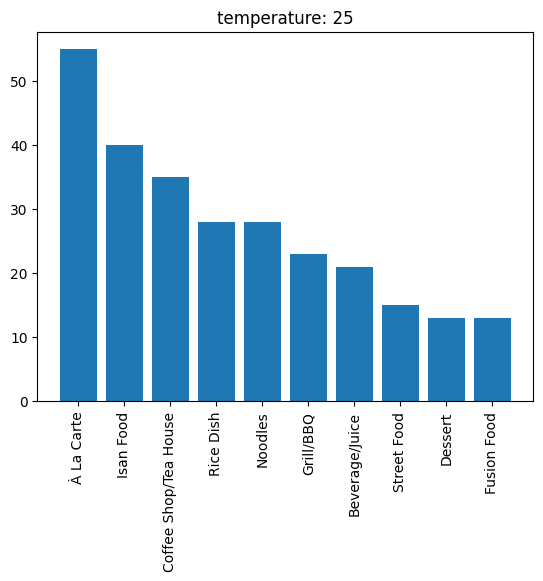

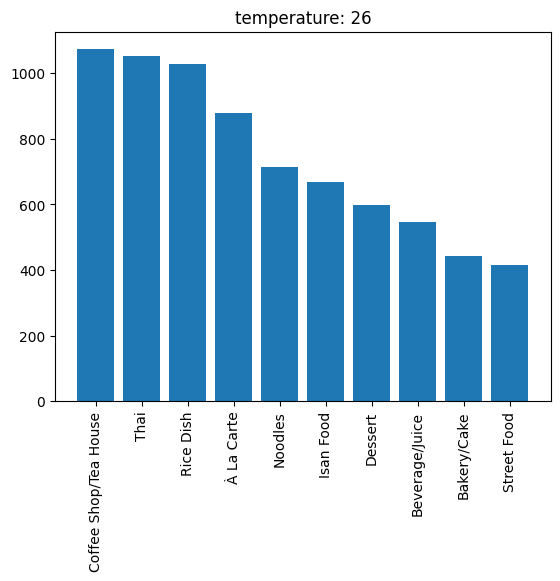

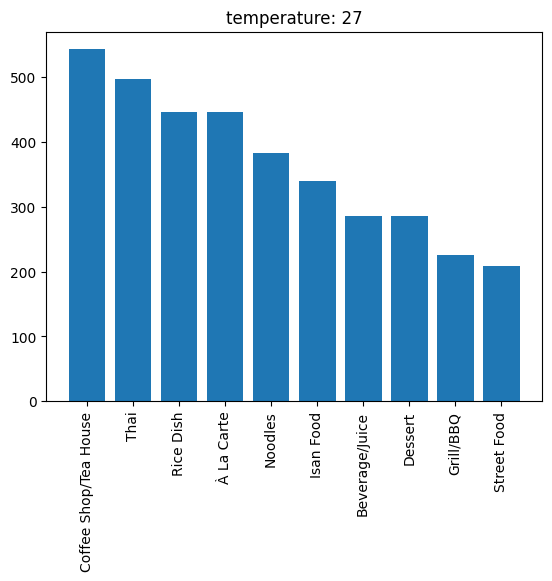

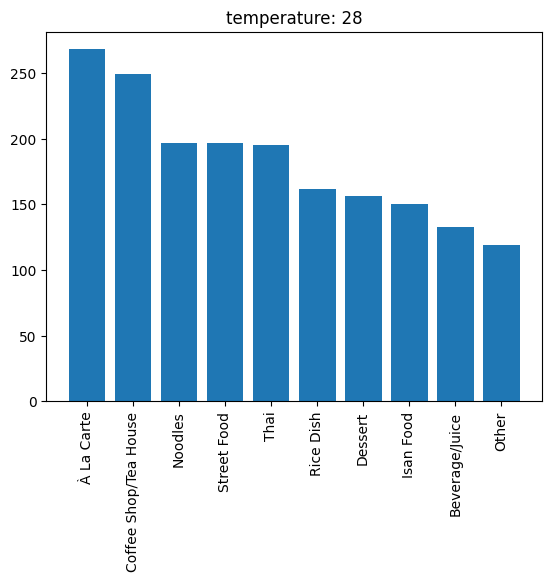

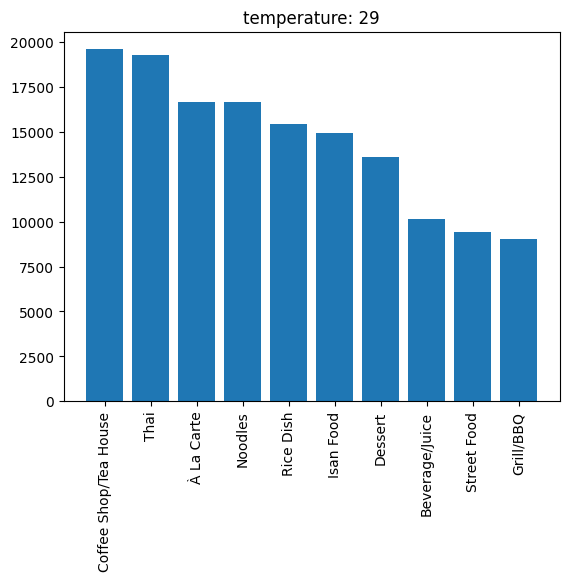

In [0]:
merged['temperature_2m'] = merged['temperature_2m'].apply(lambda x: int(x) + 1 if x - int(x) > 0.5 else int(x))
merged_grouped_temp = merged.groupby('temperature_2m')['category_international'].apply(list)

temp = 25

for t in merged_grouped_temp:
    plt.title("temperature: {temp}".format(temp=temp))
    frequency = dict(collections.Counter(t))
    top_freq = dict(sorted(frequency.items(), key=lambda x: x[1], reverse=True)[:10])
    plt.bar(top_freq.keys(), top_freq.values())
    plt.xticks(rotation=90)
    plt.show()
    temp +=1

([0, 1, 2, 3, 4, 5, 6, 7, 8],
 [Text(0, 0, '2021-06-29'),
  Text(1, 0, '2021-07-14'),
  Text(2, 0, '2021-07-15'),
  Text(3, 0, '2021-07-16'),
  Text(4, 0, '2021-07-17'),
  Text(5, 0, '2021-07-19'),
  Text(6, 0, '2021-07-20'),
  Text(7, 0, '2021-07-21'),
  Text(8, 0, '2021-07-22')])

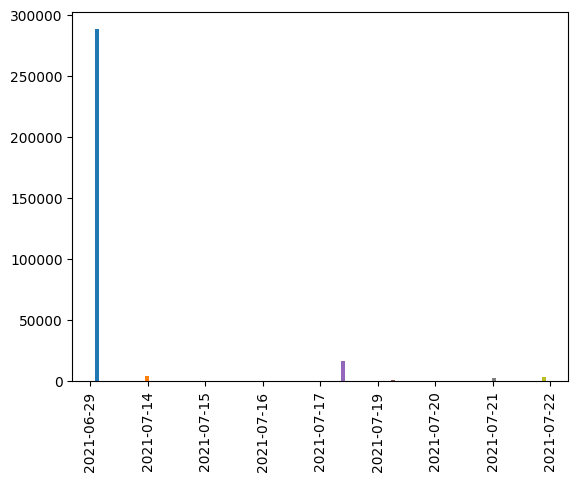

In [0]:
plt.hist(merged.groupby('date_day')['date_day'].apply(list))
plt.xticks(rotation=90)

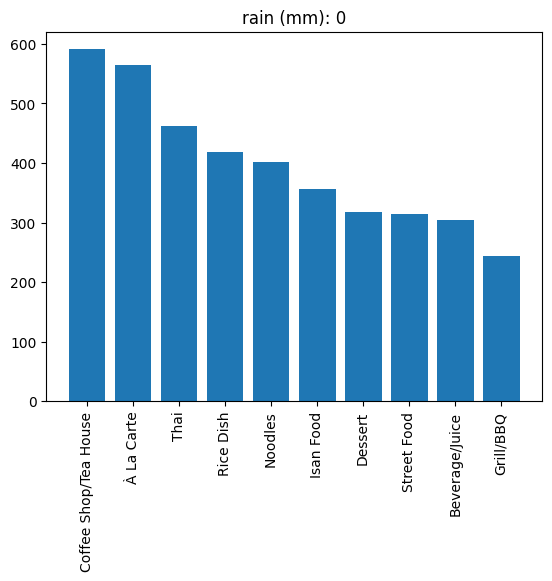

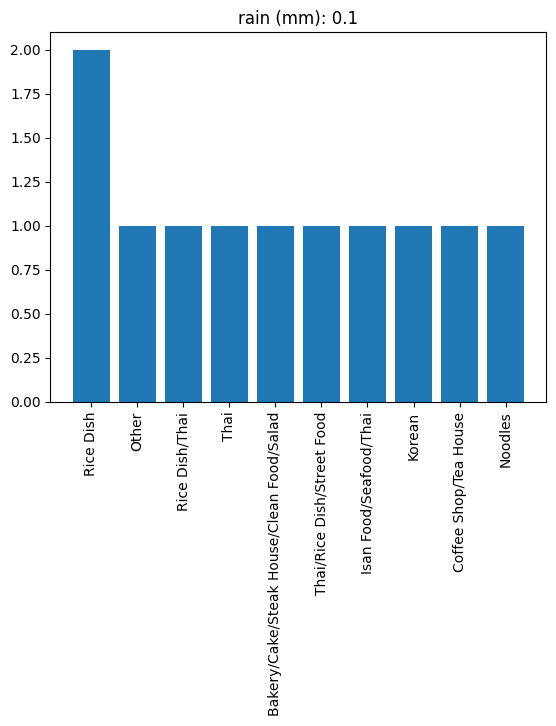

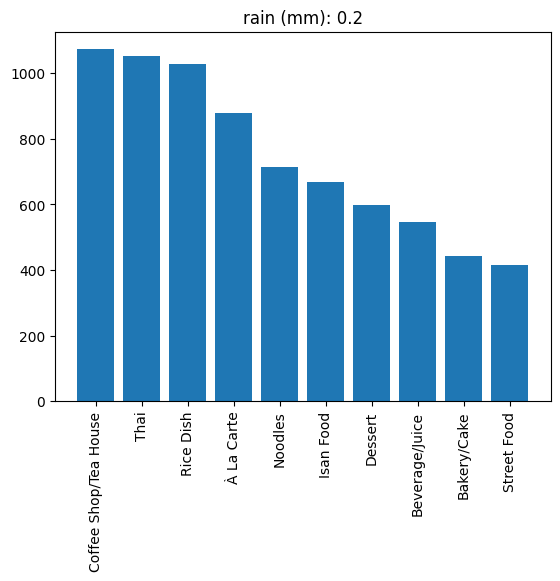

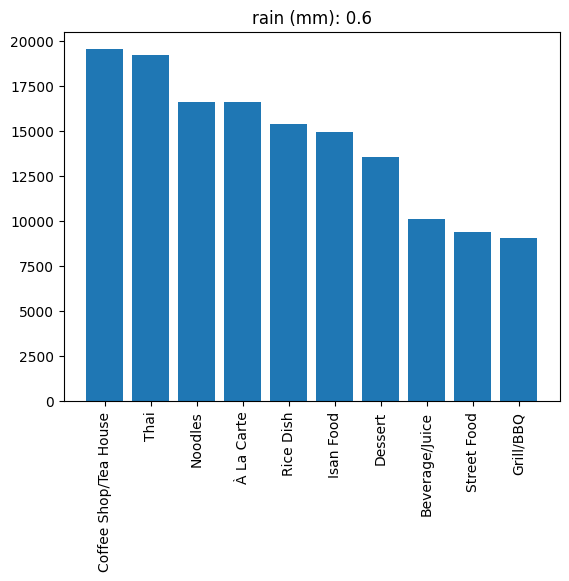

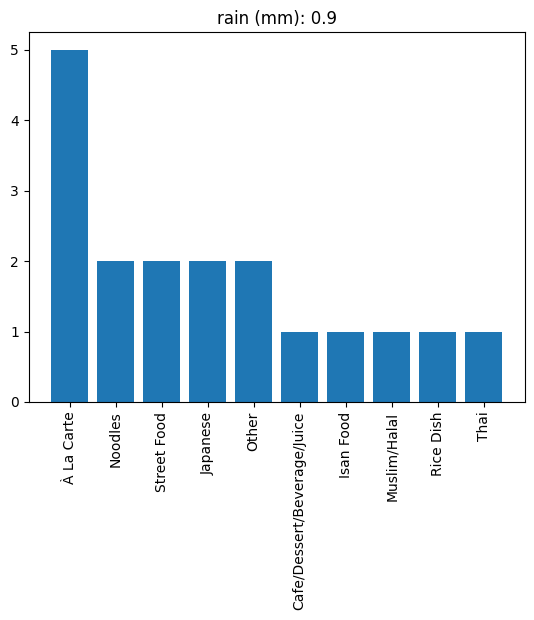

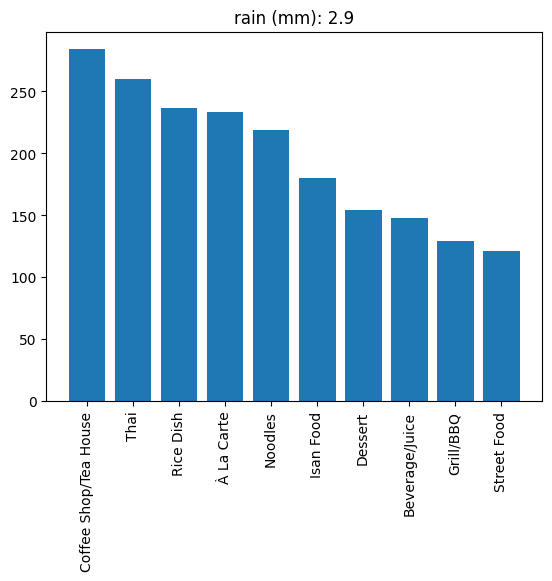

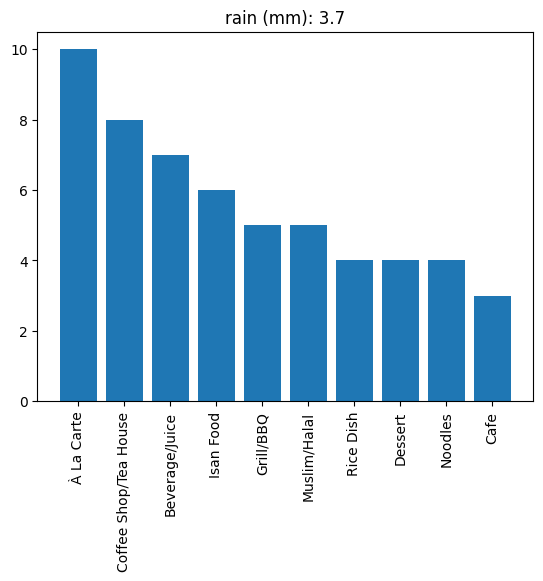

In [0]:
merged['rain'] = merged['rain'].apply(lambda x: format(float(x), ".1f"))
merged_grouped_rain = merged.groupby('rain')['category_international'].apply(list)

rain = [0,0.1,0.2,0.6,0.9,2.9,3.7]
i = 0

for t in merged_grouped_rain:
    plt.title("rain (mm): {temp}".format(temp=rain[i]))
    frequency = dict(collections.Counter(t))
    top_freq = dict(sorted(frequency.items(), key=lambda x: x[1], reverse=True)[:10])
    plt.bar(top_freq.keys(), top_freq.values())
    plt.xticks(rotation=90)
    plt.show()
    i += 1

In [0]:
display(merged_grouped_rain)

---------------------------------------------------------------------------
AttributeError                            Traceback (most recent call last)
File <command-2693603521111357>, line 11
      9 frequency = dict(collections.Counter(t))
     10 top_freq = dict(sorted(frequency.items(), key=lambda x: x[1], reverse=True)[:10])
---> 11 plt.bar(top_freq.keys(), top_freq.values(), density=True)
     12 plt.xticks(rotation=90)
     13 plt.show()

File /databricks/python/lib/python3.11/site-packages/matplotlib/pyplot.py:2439, in bar(x, height, width, bottom, align, data, **kwargs)
   2435 @_copy_docstring_and_deprecators(Axes.bar)
   2436 def bar(
   2437         x, height, width=0.8, bottom=None, *, align='center',
   2438         data=None, **kwargs):
-> 2439     return gca().bar(
   2440         x, height, width=width, bottom=bottom, align=align,
   2441         **({"data": data} if data is not None else {}), **kwargs)

File /databricks/python/lib/python3.11/site-packages/matplotlib/_

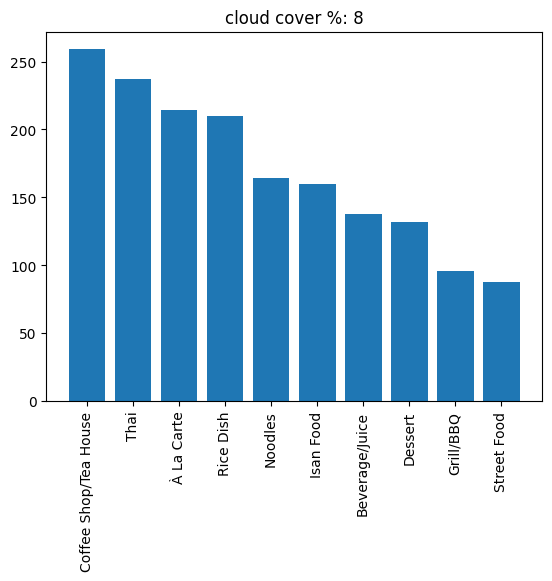

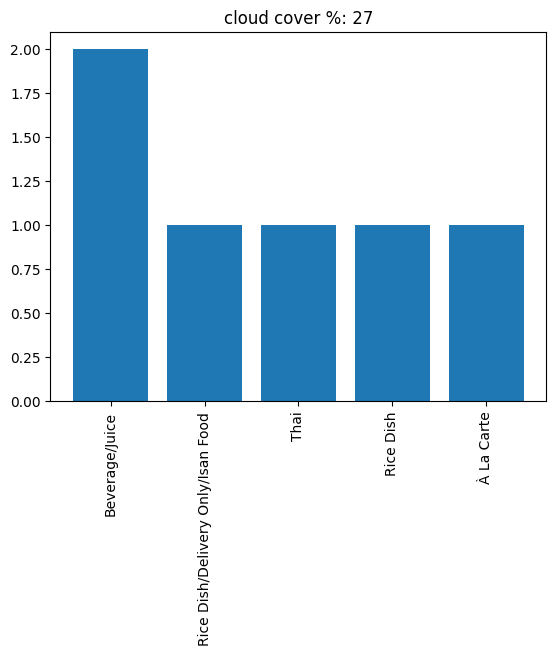

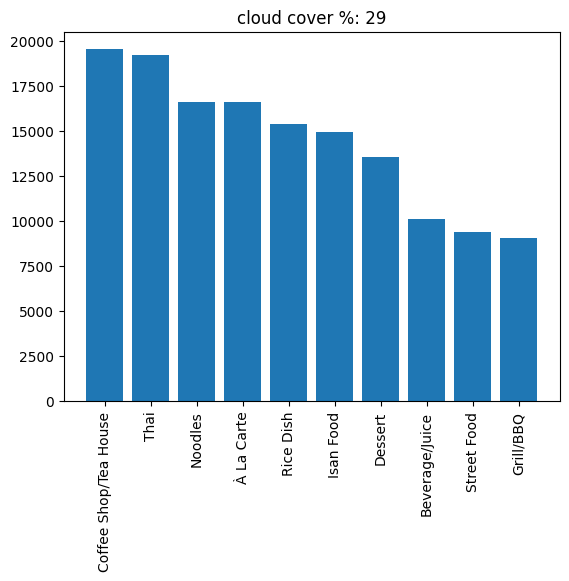

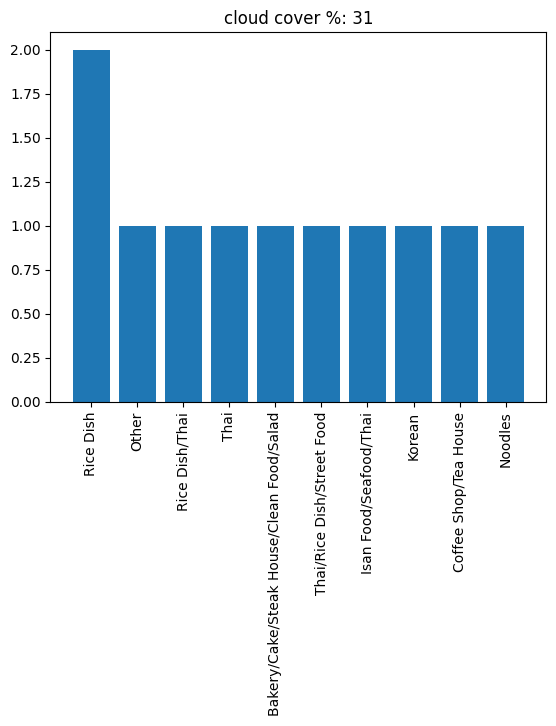

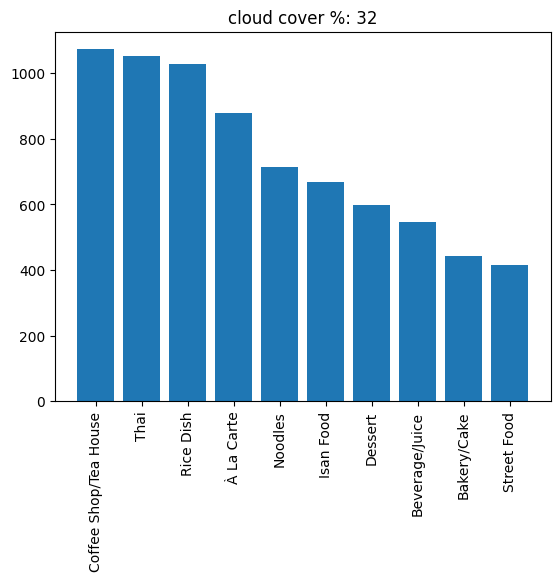

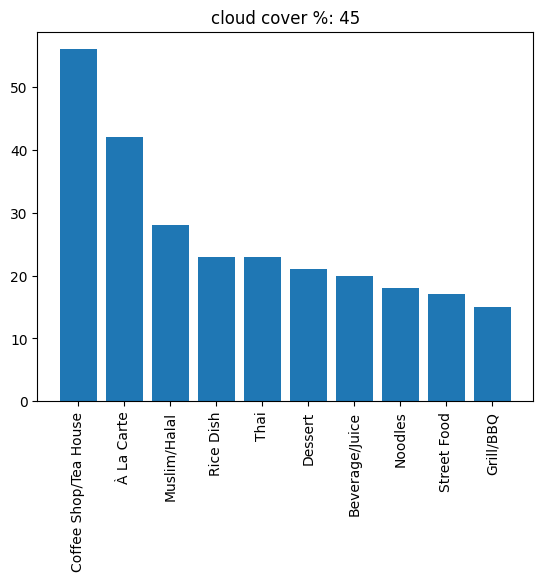

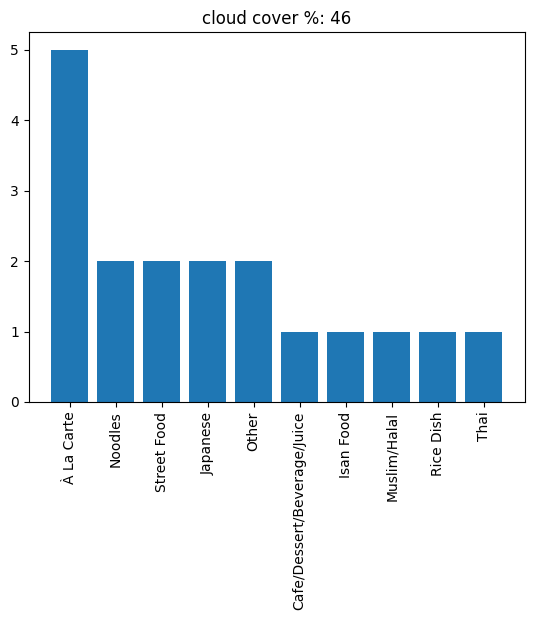

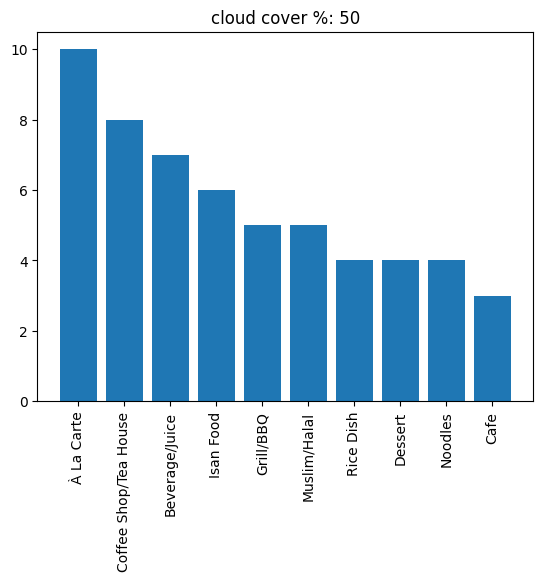

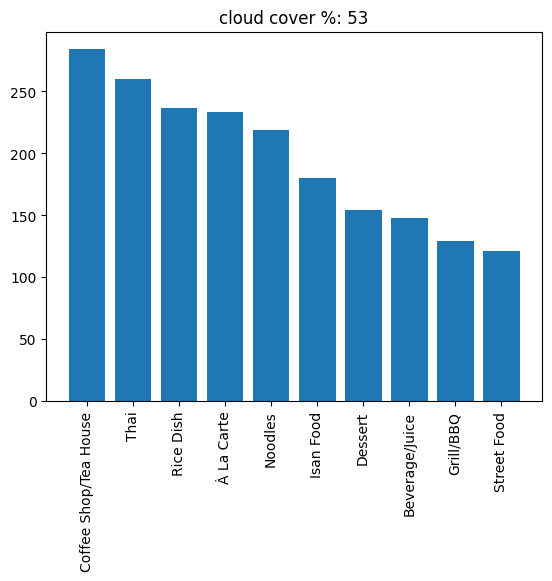

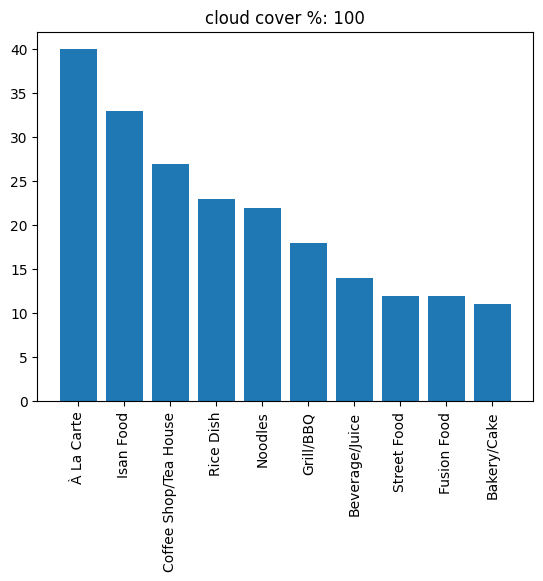

In [0]:
merged['cloud_cover'] = merged['cloud_cover'].apply(lambda x: int(x))
merged_grouped_cloud = merged.groupby('cloud_cover')['category_international'].apply(list)

cloud = [8,27,29,31,32,45,46,50,53, 100]
ind = 0

for t in merged_grouped_cloud:
    if ind ==10:
        break
    plt.title("cloud cover %: {temp}".format(temp=cloud[ind]))
    frequency = dict(collections.Counter(t))
    top_freq = dict(sorted(frequency.items(), key=lambda x: x[1], reverse=True)[:10])
    plt.bar(top_freq.keys(), top_freq.values())
    plt.xticks(rotation=90)
    plt.show()
    ind+=1

In [0]:
display(merged_grouped_cloud)

cloud_cover
35    [À La Carte, Rice Dish, Rice Dish, Noodles, Ba...
39    [Rice Dish/Delivery Only/Isan Food, Thai, Rice...
40    [Isan Food, Fast Food, Thai, Thai, Noodles/À L...
44    [Other, Rice Dish/Thai, Thai, Bakery/Cake/Stea...
54    [Shabu/Sukiyaki/Hot Pot, Beverage/Juice, Ice C...
63    [Coffee Shop/Tea House, Muslim/Halal, À La Car...
66    [À La Carte, Cafe/Dessert/Beverage/Juice, Isan...
83    [Rice Dish, Fast Food, Beverage/Juice, À La Ca...
87    [Other, Street Food, Isan Food, Other, Rice Di...
88    [À La Carte, Beverage/Juice/Thai, Vegeterian, ...
89    [Isan Food/Noodles/À La Carte, Steak House, Th...
Name: category_international, dtype: object

In [0]:
for l in line_man_pd['date_day']:
    print(l)

---------------------------------------------------------------------------
AttributeError                            Traceback (most recent call last)
File <command-2693603521111357>, line 11
      9 frequency = dict(collections.Counter(t))
     10 top_freq = dict(sorted(frequency.items(), key=lambda x: x[1], reverse=True)[:10])
---> 11 plt.bar(top_freq.keys(), top_freq.values(), density=True)
     12 plt.xticks(rotation=90)
     13 plt.show()

File /databricks/python/lib/python3.11/site-packages/matplotlib/pyplot.py:2439, in bar(x, height, width, bottom, align, data, **kwargs)
   2435 @_copy_docstring_and_deprecators(Axes.bar)
   2436 def bar(
   2437         x, height, width=0.8, bottom=None, *, align='center',
   2438         data=None, **kwargs):
-> 2439     return gca().bar(
   2440         x, height, width=width, bottom=bottom, align=align,
   2441         **({"data": data} if data is not None else {}), **kwargs)

File /databricks/python/lib/python3.11/site-packages/matplotlib/_